In [781]:
cd S:\Datasets

S:\Datasets


In [824]:
from pathlib import Path
from datetime import datetime
import csv
import pandas as pd
import numpy as np

base_path = Path.cwd().parent / 'Datasets' /  'Solar' / 'daily' / 'M18'
print(base_path)

S:\Datasets\Solar\daily\M18


In [825]:
import pandas as pd
import numpy as np

data_input = pd.concat([pd.read_csv(base_path/"CONUS_Predictions_final.csv", header=0, low_memory = False)])
grid = pd.concat([pd.read_csv(base_path/"grid.csv", header=0)])


grid['Model'] = 18

data_input.tail(14)
#print(len(data_input))

,Unnamed: 0,Month,Avg_Daily_GHI,Latitude,Longitude,Daily_Average_Power,Monthly_Average_Power,Cell
866290,33936,11,48.151203,49.0,-118.0,6.271606,7.053062,780
866291,33967,12,45.594013,49.0,-118.0,2.900194,4.678105,780
866292,33998,1,38.865723,49.0,-118.0,3.635799,7.295650,780
866293,34026,2,72.447910,49.0,-118.0,7.607103,7.131955,780
866294,34057,3,219.207950,49.0,-118.0,20.575214,13.347947,780
866295,34087,4,210.595460,49.0,-118.0,18.392008,18.298454,780
866296,34118,5,210.668490,49.0,-118.0,17.244404,21.237996,780
866297,34148,6,235.172960,49.0,-118.0,20.594824,21.609170,780
866298,34179,7,284.108730,49.0,-118.0,22.833096,20.682818,780
866299,34210,8,202.264450,49.0,-118.0,16.431469,20.907118,780


In [826]:
grid['slope 1'] = 0
grid['slope 2'] = 0
grid['slope 3'] = 0
grid['slope 4'] = 0
grid['slope 5'] = 0
grid['slope 6'] = 0
grid['slope 7'] = 0
grid['slope 8'] = 0
grid['slope 9'] = 0
grid['slope 10'] = 0
grid['slope 11'] = 0
grid['slope 12'] = 0

grid['mean 1'] = 0
grid['mean 2'] = 0
grid['mean 3'] = 0
grid['mean 4'] = 0
grid['mean 5'] = 0
grid['mean 6'] = 0
grid['mean 7'] = 0
grid['mean 8'] = 0
grid['mean 9'] = 0
grid['mean 10'] = 0
grid['mean 11'] = 0
grid['mean 12'] = 0

grid['percent_slope 1'] = 0
grid['percent_slope 2'] = 0
grid['percent_slope 3'] = 0
grid['percent_slope 4'] = 0
grid['percent_slope 5'] = 0
grid['percent_slope 6'] = 0
grid['percent_slope 7'] = 0
grid['percent_slope 8'] = 0
grid['percent_slope 9'] = 0
grid['percent_slope 10'] = 0
grid['percent_slope 11'] = 0
grid['percent_slope 12'] = 0


In [827]:
# Little slope function
# Inputs are x, y, x2, y2 and gives slope

from scipy import stats

def slope(x1, y1, x2, y2):
  z = (y2-y1)/(x2-x1)
  return z

# Slope of line function

def time_slope(y_values):
    try:
        x = range(len(y_values))
        y = y_values.values
        slope, _, _, _, _ = stats.linregress(x, y)
        return slope
    except:
        print(i, end = '\r')
        

In [828]:
# Okay, this is where we figure out the slope for each location
from statistics import mean

i = 1

for i in range(1 ,len(grid)):
    

    dfObj = pd.DataFrame(data_input) 

    # The cell corresponds to a gridded map of CONUS
    temp_data_input = dfObj[(dfObj['Cell'] == i)]
    
    temp_data_input = temp_data_input.dropna()
    
    for j in range (1,13):
        
        temp_temp_data_input = temp_data_input[(temp_data_input['Month'] == j)]

        temp_temp_data_input = temp_temp_data_input.dropna()
    

        # Each cell has an average daily power for each year (94) 
        # and we want to calculate the slope of the line for the power generated over time

        # Let's begin with the slope between each year and the year prior. That is to say year on year change. 
        # We have to skip the first in the series since it has no year prior

        temp_temp_data_input.sort_values(by="Unnamed: 0",inplace=True)

        y1 = temp_temp_data_input["Monthly_Average_Power"]
        
        s = time_slope(y1)
        
        m = y1.mean()

        grid[('slope ' + str(j))][i] = s
        grid[('mean ' + str(j))][i] = m
        
        if len(y1) == 94:
            
            try:
                # Just to be clear! This is slope / the mean production factor (pf) * 100 * the number of years projected (run)
                # Because, while percent slope is s*100, that doesn't address that pf is also a fraction of a number
                # between 0 and 30 or so depending on the local irradiance and weather. Dividing by the mean then 
                # gives us percent slope / average pf, which we multiply by run to get percent change in pf. 
                
                grid[('percent_slope ' + str(j))][i] = s/m*100*94

            except:
                grid[('percent_slope ' + str(j))][i] = 9999
                
        else:
            grid[('percent_slope ' + str(j))][i] = 9999
        
        print(i)
        print(len(y1))
    

    #print(grid['time_slope'][i])
        
    #except:
        
        #print("oops")

1
94
1
94
1
94
1
94
1
94
1
94
1
94
1
94
1
94
1
94
1
94
1
94
2
94
2
94
2
94
2
94
2
94
2
94
2
94
2
94
2
94
2
94
2
94
2
94
3
94
3
94
3
94
3
94
3
94
3
94
3
94
3
94
3
94
3
94
3
94
3
94
4
0
4
0
4
0
4
0
4
0
4
0
4
0
4
0
4
0
4
0
4
0
4
0


C:\Users\Cody\AppData\Local\Temp\ipykernel_12460\287968007.py:43: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  grid[('mean ' + str(j))][i] = m
C:\Users\Cody\anaconda3\envs\Tensorflow_GPU\lib\site-packages\pandas\core\indexing.py:1732: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  self._setitem_single_block(indexer, value, name)
C:\Users\Cody\AppData\Local\Temp\ipykernel_12460\287968007.py:59: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-cop

5
94
5
94
5
94
5
94
5
94
5
94
5
94
5
94
5
94
5
94
5
94
5
94
6
94
6
94
6
94
6
94
6
94
6
94
6
94
6
94
6
94
6
94
6
94
6
94
7
94
7
94
7
94
7
94
7
94
7
94
7
94
7
94
7
94
7
94
7
94
7
94
8
94
8
94
8
94
8
94
8
94
8
94
8
94
8
94
8
94
8
94
8
94
8
94
9
94
9
94
9
94
9
94
9
94
9
94
9
94
9
94
9
94
9
94
9
94
9
94
10
94
10
94
10
94
10
94
10
94
10
94
10
94
10
94
10
94
10
94
10
94
10
94
11
94
11
94
11
94
11
94
11
94
11
94
11
94
11
94
11
94
11
94
11
94
11
94
12
94
12
94
12
94
12
94
12
94
12
94
12
94
12
94
12
94
12
94
12
94
12
94
13
94
13
94
13
94
13
94
13
94
13
94
13
94
13
94
13
94
13
94
13
94
13
94
14
94
14
94
14
94
14
94
14
94
14
94
14
94
14
94
14
94
14
94
14
94
14
94
15
94
15
94
15
94
15
94
15
94
15
94
15
94
15
94
15
94
15
94
15
94
15
94
16
94
16
94
16
94
16
94
16
94
16
94
16
94
16
94
16
94
16
94
16
94
16
94
17
94
17
94
17
94
17
94
17
94
17
94
17
94
17
94
17
94
17
94
17
94
17
94
18
94
18
94
18
94
18
94
18
94
18
94
18
94
18
94
18
94
18
94
18
94
18
94
19
94
19
94
19
94
19
94
19
94
19
94
19
94
19
94
19
9

119
94
119
94
119
94
119
94
119
94
119
94
119
94
120
94
120
94
120
94
120
94
120
94
120
94
120
94
120
94
120
94
120
94
120
94
120
94
121
94
121
94
121
94
121
94
121
94
121
94
121
94
121
94
121
94
121
94
121
94
121
94
122
94
122
94
122
94
122
94
122
94
122
94
122
94
122
94
122
94
122
94
122
94
122
94
123
94
123
94
123
94
123
94
123
94
123
94
123
94
123
94
123
94
123
94
123
94
123
94
124
94
124
94
124
94
124
94
124
94
124
94
124
94
124
94
124
94
124
94
124
94
124
94
125
94
125
94
125
94
125
94
125
94
125
94
125
94
125
94
125
94
125
94
125
94
125
94
126
94
126
94
126
94
126
94
126
94
126
94
126
94
126
94
126
94
126
94
126
94
126
94
127
94
127
94
127
94
127
94
127
94
127
94
127
94
127
94
127
94
127
94
127
94
127
94
128
94
128
94
128
94
128
94
128
94
128
94
128
94
128
94
128
94
128
94
128
94
128
94
129
94
129
94
129
94
129
94
129
94
129
94
129
94
129
94
129
94
129
94
129
94
129
94
130
94
130
94
130
94
130
94
130
94
130
94
130
94
130
94
130
94
130
94
130
94
130
94
131
94
131
94
131
94
131
94

220
94
220
94
220
94
220
94
220
94
220
94
220
94
220
94
220
94
220
94
220
94
220
94
221
94
221
94
221
94
221
94
221
94
221
94
221
94
221
94
221
94
221
94
221
94
221
94
222
94
222
94
222
94
222
94
222
94
222
94
222
94
222
94
222
94
222
94
222
94
222
94
223
94
223
94
223
94
223
94
223
94
223
94
223
94
223
94
223
94
223
94
223
94
223
94
224
94
224
94
224
94
224
94
224
94
224
94
224
94
224
94
224
94
224
94
224
94
224
94
225
94
225
94
225
94
225
94
225
94
225
94
225
94
225
94
225
94
225
94
225
94
225
94
226
94
226
94
226
94
226
94
226
94
226
94
226
94
226
94
226
94
226
94
226
94
226
94
227
94
227
94
227
94
227
94
227
94
227
94
227
94
227
94
227
94
227
94
227
94
227
94
228
94
228
94
228
94
228
94
228
94
228
94
228
94
228
94
228
94
228
94
228
94
228
94
229
94
229
94
229
94
229
94
229
94
229
94
229
94
229
94
229
94
229
94
229
94
229
94
230
94
230
94
230
94
230
94
230
94
230
94
230
94
230
94
230
94
230
94
230
94
230
94
231
94
231
94
231
94
231
94
231
94
231
94
231
94
231
94
231
94
231
94
231
94

320
94
320
94
320
94
320
94
320
94
320
94
320
94
320
94
320
94
320
94
321
94
321
94
321
94
321
94
321
94
321
94
321
94
321
94
321
94
321
94
321
94
321
94
322
94
322
94
322
94
322
94
322
94
322
94
322
94
322
94
322
94
322
94
322
94
322
94
323
94
323
94
323
94
323
94
323
94
323
94
323
94
323
94
323
94
323
94
323
94
323
94
324
94
324
94
324
94
324
94
324
94
324
94
324
94
324
94
324
94
324
94
324
94
324
94
325
94
325
94
325
94
325
94
325
94
325
94
325
94
325
94
325
94
325
94
325
94
325
94
326
94
326
94
326
94
326
94
326
94
326
94
326
94
326
94
326
94
326
94
326
94
326
94
327
94
327
94
327
94
327
94
327
94
327
94
327
94
327
94
327
94
327
94
327
94
327
94
328
94
328
94
328
94
328
94
328
94
328
94
328
94
328
94
328
94
328
94
328
94
328
94
329
94
329
94
329
94
329
94
329
94
329
94
329
94
329
94
329
94
329
94
329
94
329
94
330
94
330
94
330
94
330
94
330
94
330
94
330
94
330
94
330
94
330
94
330
94
330
94
331
94
331
94
331
94
331
94
331
94
331
94
331
94
331
94
331
94
331
94
331
94
331
94
332
94

420
94
420
94
420
94
420
94
420
94
420
94
420
94
420
94
420
94
420
94
421
94
421
94
421
94
421
94
421
94
421
94
421
94
421
94
421
94
421
94
421
94
421
94
422
94
422
94
422
94
422
94
422
94
422
94
422
94
422
94
422
94
422
94
422
94
422
94
423
94
423
94
423
94
423
94
423
94
423
94
423
94
423
94
423
94
423
94
423
94
423
94
424
94
424
94
424
94
424
94
424
94
424
94
424
94
424
94
424
94
424
94
424
94
424
94
425
94
425
94
425
94
425
94
425
94
425
94
425
94
425
94
425
94
425
94
425
94
425
94
426
94
426
94
426
94
426
94
426
94
426
94
426
94
426
94
426
94
426
94
426
94
426
94
427
94
427
94
427
94
427
94
427
94
427
94
427
94
427
94
427
94
427
94
427
94
427
94
428
94
428
94
428
94
428
94
428
94
428
94
428
94
428
94
428
94
428
94
428
94
428
94
429
94
429
94
429
94
429
94
429
94
429
94
429
94
429
94
429
94
429
94
429
94
429
94
430
94
430
94
430
94
430
94
430
94
430
94
430
94
430
94
430
94
430
94
430
94
430
94
431
94
431
94
431
94
431
94
431
94
431
94
431
94
431
94
431
94
431
94
431
94
431
94
432
94

518
94
518
94
519
94
519
94
519
94
519
94
519
94
519
94
519
94
519
94
519
94
519
94
519
94
519
94
520
94
520
94
520
94
520
94
520
94
520
94
520
94
520
94
520
94
520
94
520
94
520
94
521
94
521
94
521
94
521
94
521
94
521
94
521
94
521
94
521
94
521
94
521
94
521
94
522
94
522
94
522
94
522
94
522
94
522
94
522
94
522
94
522
94
522
94
522
94
522
94
523
94
523
94
523
94
523
94
523
94
523
94
523
94
523
94
523
94
523
94
523
94
523
94
524
94
524
94
524
94
524
94
524
94
524
94
524
94
524
94
524
94
524
94
524
94
524
94
525
94
525
94
525
94
525
94
525
94
525
94
525
94
525
94
525
94
525
94
525
94
525
94
526
94
526
94
526
94
526
94
526
94
526
94
526
94
526
94
526
94
526
94
526
94
526
94
527
94
527
94
527
94
527
94
527
94
527
94
527
94
527
94
527
94
527
94
527
94
527
94
528
94
528
94
528
94
528
94
528
94
528
94
528
94
528
94
528
94
528
94
528
94
528
94
529
94
529
94
529
94
529
94
529
94
529
94
529
94
529
94
529
94
529
94
529
94
529
94
530
94
530
94
530
94
530
94
530
94
530
94
530
94
530
94
530
94

620
94
620
94
620
94
620
94
620
94
620
94
620
94
620
94
621
94
621
94
621
94
621
94
621
94
621
94
621
94
621
94
621
94
621
94
621
94
621
94
622
94
622
94
622
94
622
94
622
94
622
94
622
94
622
94
622
94
622
94
622
94
622
94
623
94
623
94
623
94
623
94
623
94
623
94
623
94
623
94
623
94
623
94
623
94
623
94
624
94
624
94
624
94
624
94
624
94
624
94
624
94
624
94
624
94
624
94
624
94
624
94
625
94
625
94
625
94
625
94
625
94
625
94
625
94
625
94
625
94
625
94
625
94
625
94
626
94
626
94
626
94
626
94
626
94
626
94
626
94
626
94
626
94
626
94
626
94
626
94
627
94
627
94
627
94
627
94
627
94
627
94
627
94
627
94
627
94
627
94
627
94
627
94
628
94
628
94
628
94
628
94
628
94
628
94
628
94
628
94
628
94
628
94
628
94
628
94
629
94
629
94
629
94
629
94
629
94
629
94
629
94
629
94
629
94
629
94
629
94
629
94
630
94
630
94
630
94
630
94
630
94
630
94
630
94
630
94
630
94
630
94
630
94
630
94
631
0
631
0
631
0
631
0
631
0
631
0
631
0
631
0
631
0
631
0
631
0
631
0
632
94
632
94
632
94
632
94
632


721
94
721
94
721
94
721
94
722
94
722
94
722
94
722
94
722
94
722
94
722
94
722
94
722
94
722
94
722
94
722
94
723
94
723
94
723
94
723
94
723
94
723
94
723
94
723
94
723
94
723
94
723
94
723
94
724
94
724
94
724
94
724
94
724
94
724
94
724
94
724
94
724
94
724
94
724
94
724
94
725
94
725
94
725
94
725
94
725
94
725
94
725
94
725
94
725
94
725
94
725
94
725
94
726
94
726
94
726
94
726
94
726
94
726
94
726
94
726
94
726
94
726
94
726
94
726
94
727
94
727
94
727
94
727
94
727
94
727
94
727
94
727
94
727
94
727
94
727
94
727
94
728
94
728
94
728
94
728
94
728
94
728
94
728
94
728
94
728
94
728
94
728
94
728
94
729
94
729
94
729
94
729
94
729
94
729
94
729
94
729
94
729
94
729
94
729
94
729
94
730
94
730
94
730
94
730
94
730
94
730
94
730
94
730
94
730
94
730
94
730
94
730
94
731
94
731
94
731
94
731
94
731
94
731
94
731
94
731
94
731
94
731
94
731
94
731
94
732
94
732
94
732
94
732
94
732
94
732
94
732
94
732
94
732
94
732
94
732
94
732
94
733
94
733
94
733
94
733
94
733
94
733
94
733
94

In [829]:
import statistics

grid = grid.dropna()

open(base_path / 'slope_final.csv', 'w')

grid.to_csv(base_path / 'slope_final.csv')

grid.head()

,Cell,Lat,Long,Model,slope 1,slope 2,slope 3,slope 4,slope 5,slope 6,...,percent_slope 3,percent_slope 4,percent_slope 5,percent_slope 6,percent_slope 7,percent_slope 8,percent_slope 9,percent_slope 10,percent_slope 11,percent_slope 12
0,1,26,-98,18,0.000000,0.000000,0.000000,0.000000,0.000000,0.000000,...,0,0,0,0,0,0,0,0,0,0
1,2,27,-99,18,0.000000,0.000000,0.000000,0.000000,0.000000,0.000000,...,-1,-2,2,3,1,0,-3,0,4,2
2,3,27,-98,18,0.000000,0.000000,0.000000,0.000000,0.000000,0.000000,...,-1,-3,1,2,0,0,-2,0,5,3
3,4,26,-81,18,0.000000,0.000000,0.000000,0.000000,0.000000,0.000000,...,-1,-1,-2,0,1,0,0,-2,3,0
5,6,28,-99,18,0.000597,-0.000581,-0.002368,-0.003701,0.004366,0.007358,...,-1,-1,2,3,0,0,-3,-1,3,2


In [830]:
import rasterio
import geopandas as gp
from shapely.geometry import Point, Polygon

In [831]:
#Create a geodataframe for handling location data to be mapped
geo_metrics = gp.GeoDataFrame()

In [832]:
geo_metrics['geometry'] = None

In [833]:
for i in range(0, len(grid)):
# And create point data from our lat / long pairs in metrics    
    try:
        geo_metrics.loc[i, 'geometry'] = Point(grid['Long'][i], grid['Lat'][i])
        
    except:
        
        pass

In [834]:
# We'll just copy over the other metrics values as well
geo_metrics['slope 1'] = grid['percent_slope 1']
geo_metrics['slope 2'] = grid['percent_slope 2']
geo_metrics['slope 3'] = grid['percent_slope 3']
geo_metrics['slope 4'] = grid['percent_slope 4']
geo_metrics['slope 5'] = grid['percent_slope 5']
geo_metrics['slope 6'] = grid['percent_slope 6']
geo_metrics['slope 7'] = grid['percent_slope 7']
geo_metrics['slope 8'] = grid['percent_slope 8']
geo_metrics['slope 9'] = grid['percent_slope 9']
geo_metrics['slope 10'] = grid['percent_slope 10']
geo_metrics['slope 11'] = grid['percent_slope 11']
geo_metrics['slope 12'] = grid['percent_slope 12']

geo_metrics['Cell'] = grid['Cell']

In [835]:
from fiona.crs import from_epsg
# Set the coordinate reference system to global GPS
geo_metrics.crs = from_epsg(4326)
# and export to a shapefile
geo_metrics.to_file(base_path /'geo_metrics_CONUS.shp')

C:\Users\Cody\anaconda3\envs\Tensorflow_GPU\lib\site-packages\pyproj\crs\crs.py:53: FutureWarning: '+init=<authority>:<code>' syntax is deprecated. '<authority>:<code>' is the preferred initialization method. When making the change, be mindful of axis order changes: https://pyproj4.github.io/pyproj/stable/gotchas.html#axis-order-changes-in-proj-6
  return _prepare_from_string(" ".join(pjargs))


In [836]:
# We'll just go ahead and import the file we just saved for immediate use
sites = gp.read_file(base_path / 'geo_metrics_CONUS.shp')

In [837]:
# We import a basemap I made in Arc Pro that covers the extent of the dataset

basemap = rasterio.open(base_path /'Layout2.tif')

band_1 = basemap.read(4)
band_2 = basemap.read(3)
band_3 = basemap.read(2)
band_4 = basemap.read(1)

map_stack = np.dstack((band_4, band_3, band_2, band_1))

In [838]:
# and set the extent so it can be graphed alongside our shapefile

extent = [-14040349.345523778, -7444312.377578014, 2049207.2904239604, 7146144.947472963]

# Also cast the shapefile into a compatible CRS
sites = sites.to_crs(from_epsg(3857))
#basemap.crs

C:\Users\Cody\anaconda3\envs\Tensorflow_GPU\lib\site-packages\pyproj\crs\crs.py:53: FutureWarning: '+init=<authority>:<code>' syntax is deprecated. '<authority>:<code>' is the preferred initialization method. When making the change, be mindful of axis order changes: https://pyproj4.github.io/pyproj/stable/gotchas.html#axis-order-changes-in-proj-6
  return _prepare_from_string(" ".join(pjargs))


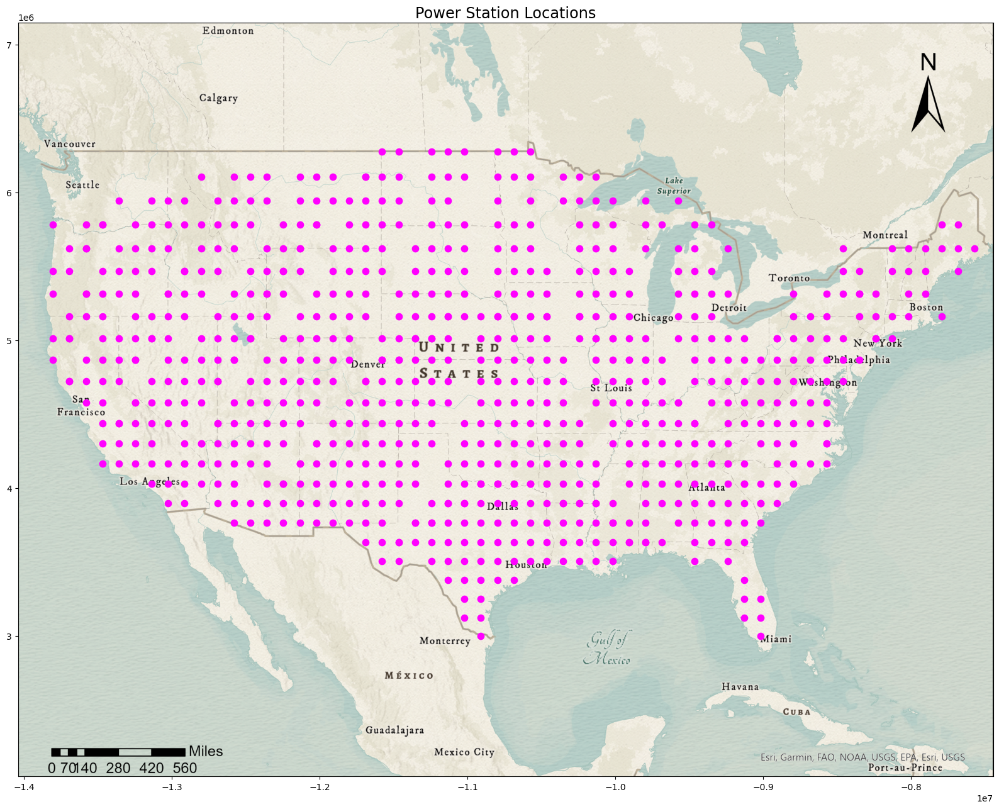

In [839]:
# Let's plot the data, nothing fancy, just pink dots at all the site locations
%matplotlib inline
import matplotlib.pyplot as plt
from rasterio import plot as rasterplot

fig, ax = plt.subplots(figsize = (20,20))

rasterplot.show(basemap, ax = ax, cmap = 'gray', extent = extent)

plt.title('Power Station Locations', fontsize = 'xx-large')

sites.plot(ax = ax, color = 'fuchsia', legend = True, markersize = 55)

plt.savefig(base_path / 'locations.pdf')

plt.show()

In [840]:
#print(max(grid['slope 1'], grid['slope 2']))

grid['max'] = (grid[['percent_slope 1', 'percent_slope 2', 'percent_slope 3', 'percent_slope 4', 'percent_slope 5', 'percent_slope 6', 'percent_slope 7', 'percent_slope 8', 'percent_slope 9', 'percent_slope 10', 'percent_slope 11', 'percent_slope 12']].values.max(1))
grid['min'] = (grid[['percent_slope 1', 'percent_slope 2', 'percent_slope 3', 'percent_slope 4', 'percent_slope 5', 'percent_slope 6', 'percent_slope 7', 'percent_slope 8', 'percent_slope 9', 'percent_slope 10', 'percent_slope 11', 'percent_slope 12']].values.min(1))

print(max(grid['max']))
print(min(grid['min']))

miniv = -25
maxiv = 25

colormap = "coolwarm"


12
-34


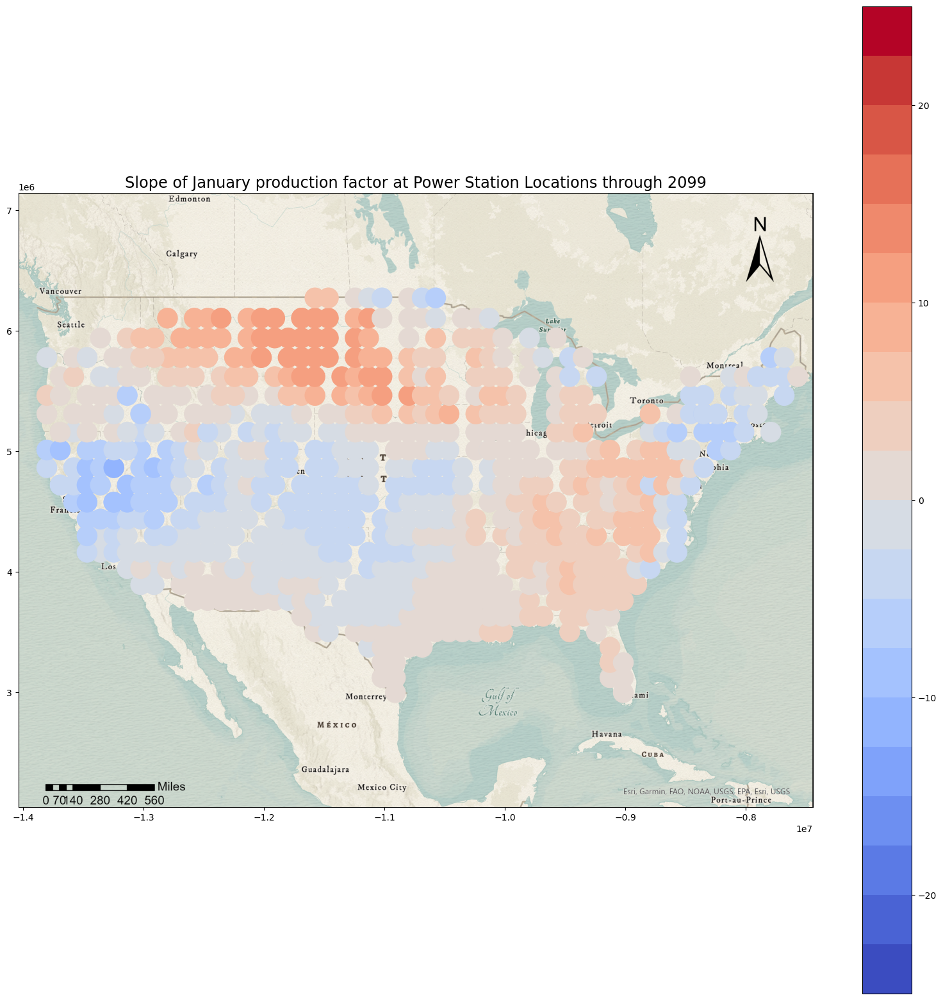

In [841]:
# Plotting temperature across all locations
from rasterio import plot as rasterplot
import matplotlib as mpl

N = 20

cmap = plt.get_cmap(colormap, N)

fig, ax = plt.subplots(figsize = (20,20))

rasterplot.show(basemap, ax = ax, cmap = 'gray', extent = extent)

sites.plot(ax = ax, column = 'slope 1', cmap = cmap, legend = True, markersize = 500, marker = 'o', vmin = miniv, vmax = maxiv)

plt.title('Slope of January production factor at Power Station Locations through 2099', fontsize = 'xx-large')

plt.savefig(base_path / 'slope_Jan.pdf')
plt.savefig(base_path / '1.png')

plt.show()

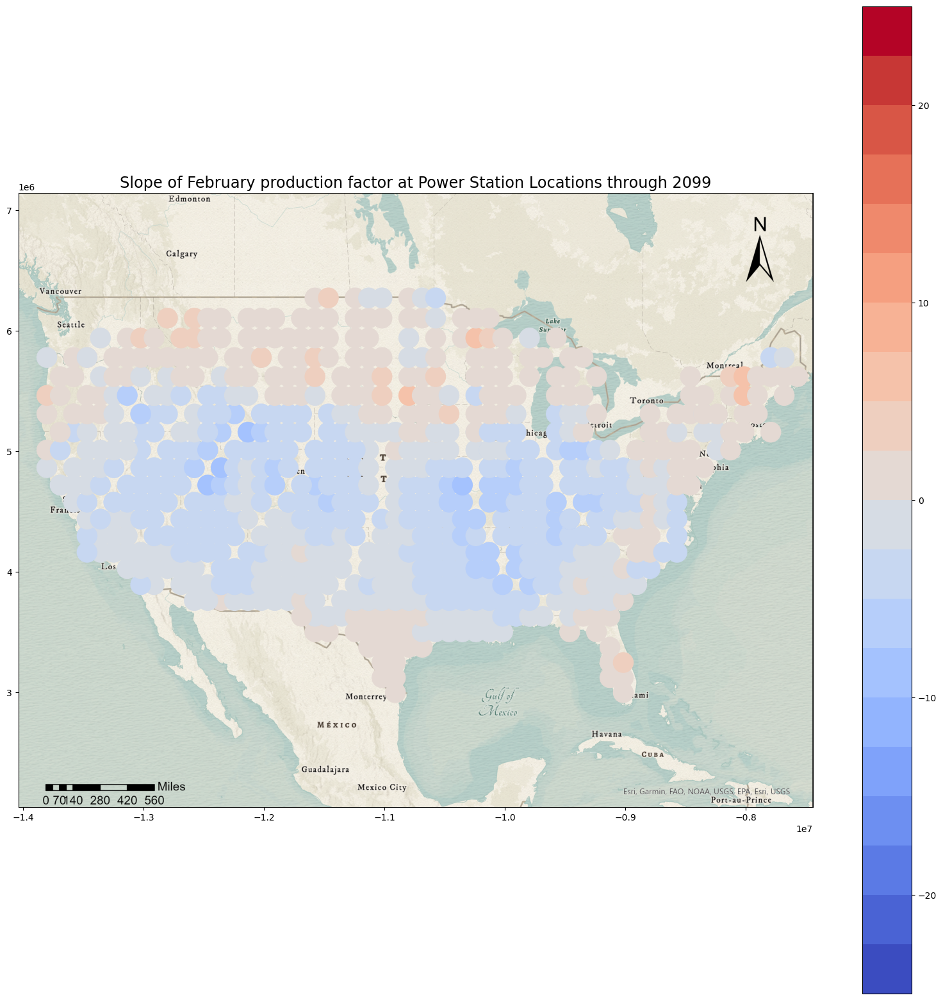

In [842]:
# Plotting temperature across all locations
from rasterio import plot as rasterplot
import matplotlib as mpl

N = 20

cmap = plt.get_cmap(colormap, N)

fig, ax = plt.subplots(figsize = (20,20))

rasterplot.show(basemap, ax = ax, cmap = 'gray', extent = extent)

sites.plot(ax = ax, column = 'slope 2', cmap = cmap, legend = True, markersize = 500, marker = 'o', vmin = miniv, vmax = maxiv)

plt.title('Slope of February production factor at Power Station Locations through 2099', fontsize = 'xx-large')

plt.savefig(base_path / 'slope_Feb.pdf')
plt.savefig(base_path / '2.png')

plt.show()



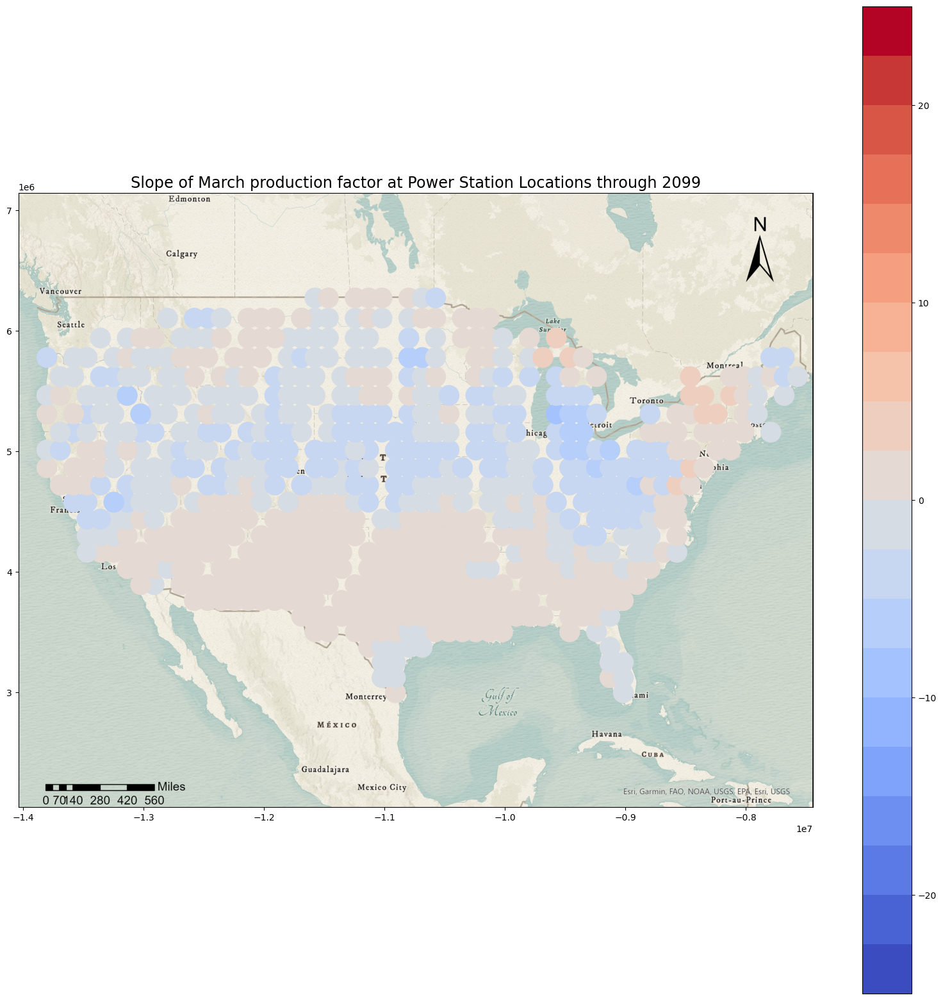

In [843]:
# Plotting temperature across all locations
from rasterio import plot as rasterplot
import matplotlib as mpl

N = 20

cmap = plt.get_cmap(colormap, N)

fig, ax = plt.subplots(figsize = (20,20))

rasterplot.show(basemap, ax = ax, cmap = 'gray', extent = extent)

sites.plot(ax = ax, column = 'slope 3', cmap = cmap, legend = True, markersize = 500, marker = 'o', vmin = miniv, vmax = maxiv)

plt.title('Slope of March production factor at Power Station Locations through 2099', fontsize = 'xx-large')

plt.savefig(base_path / 'slope_march.pdf')
plt.savefig(base_path / '3.png')

plt.show()



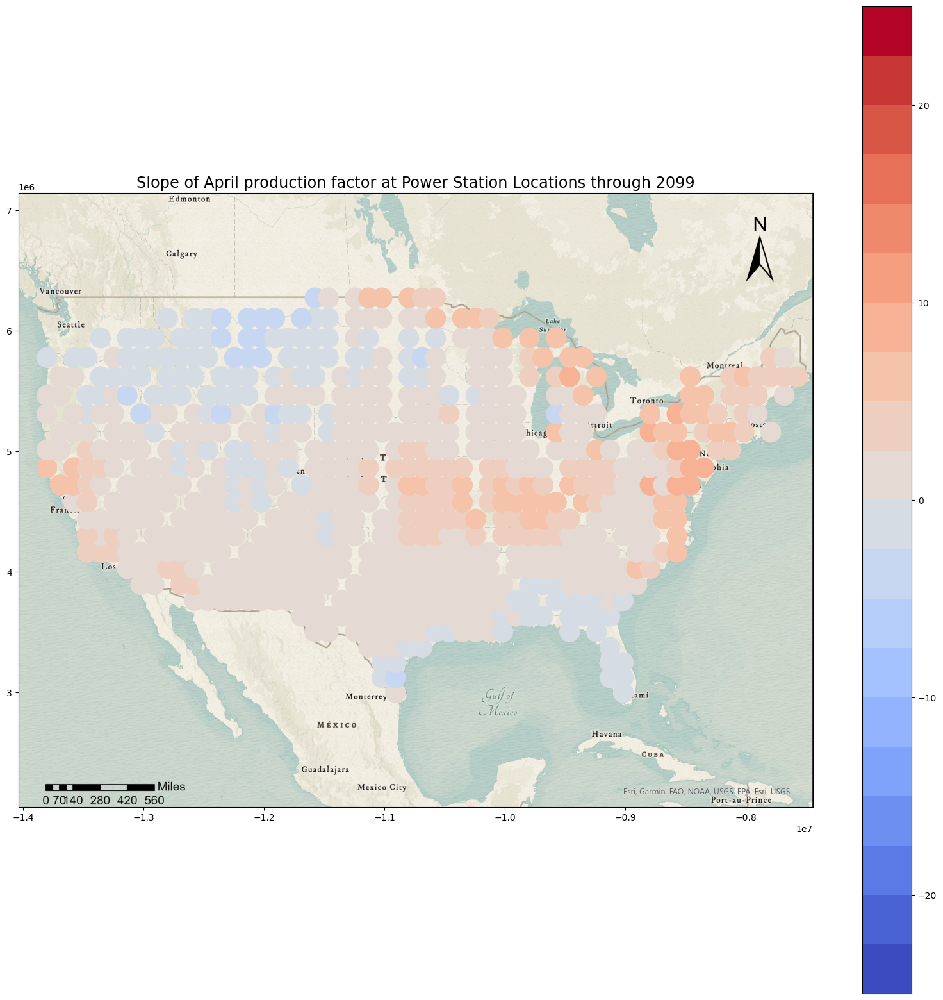

In [844]:
# Plotting temperature across all locations
from rasterio import plot as rasterplot
import matplotlib as mpl

N = 20

cmap = plt.get_cmap(colormap, N)

fig, ax = plt.subplots(figsize = (20,20))

rasterplot.show(basemap, ax = ax, cmap = 'gray', extent = extent)

sites.plot(ax = ax, column = 'slope 4', cmap = cmap, legend = True, markersize = 500, marker = 'o', vmin = miniv, vmax = maxiv)

plt.title('Slope of April production factor at Power Station Locations through 2099', fontsize = 'xx-large')

plt.savefig(base_path / 'slope_April.pdf')
plt.savefig(base_path / '4.png')

plt.show()



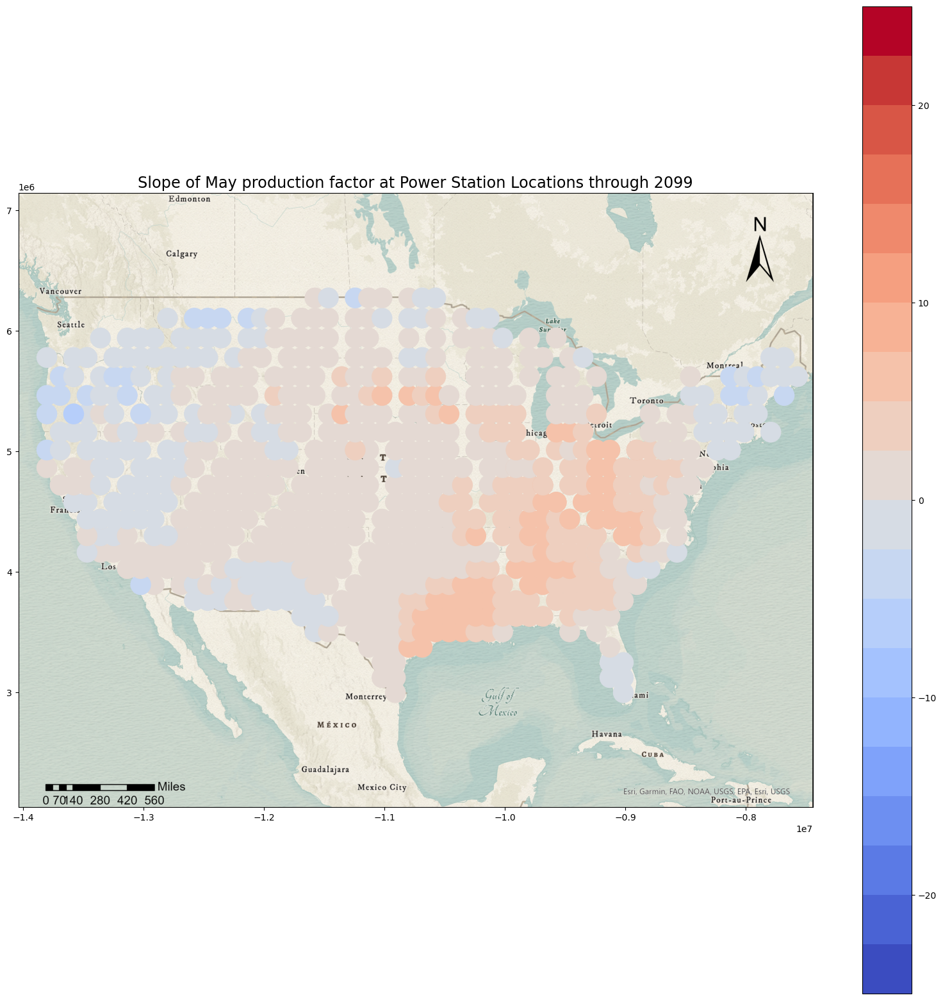

In [845]:
# Plotting temperature across all locations
from rasterio import plot as rasterplot
import matplotlib as mpl

N = 20

cmap = plt.get_cmap(colormap, N)

fig, ax = plt.subplots(figsize = (20,20))

rasterplot.show(basemap, ax = ax, cmap = 'gray', extent = extent)

sites.plot(ax = ax, column = 'slope 5', cmap = cmap, legend = True, markersize = 500, marker = 'o', vmin = miniv, vmax = maxiv)

plt.title('Slope of May production factor at Power Station Locations through 2099', fontsize = 'xx-large')

plt.savefig(base_path / 'slope_May.pdf')
plt.savefig(base_path / '5.png')

plt.show()



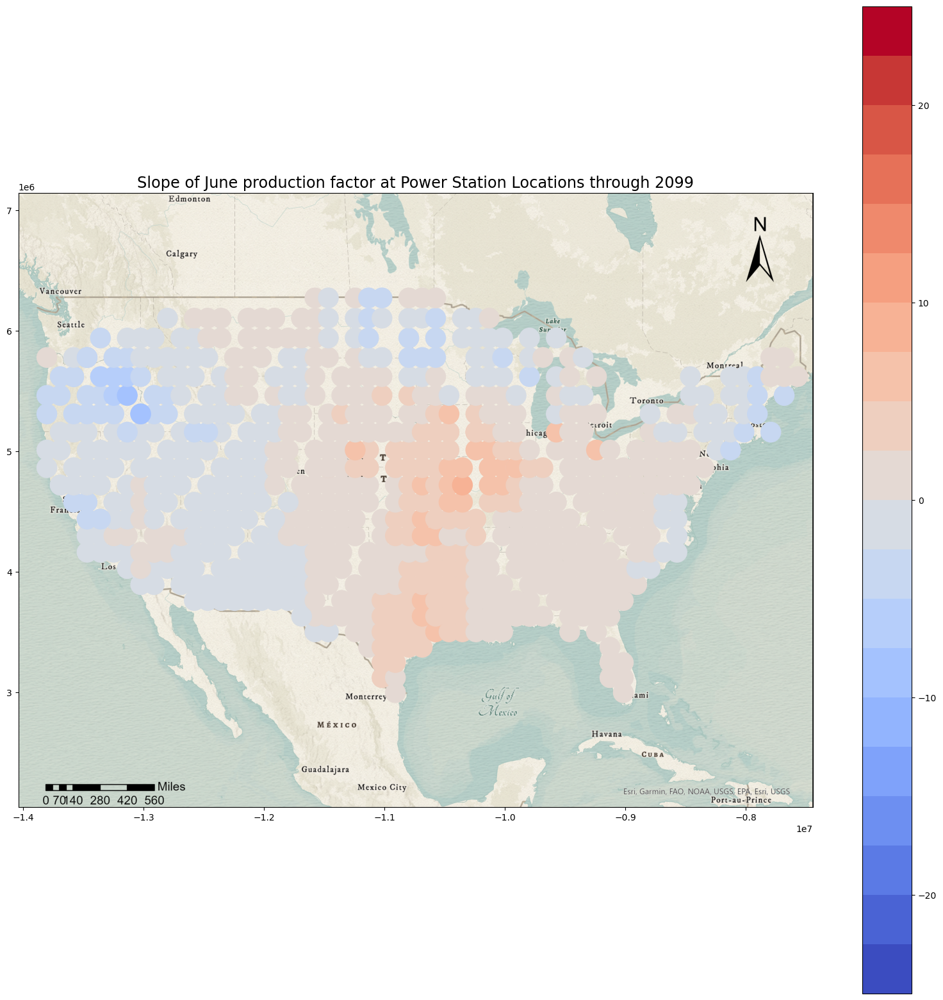

In [846]:
# Plotting temperature across all locations
from rasterio import plot as rasterplot
import matplotlib as mpl

N = 20

cmap = plt.get_cmap(colormap, N)

fig, ax = plt.subplots(figsize = (20,20))

rasterplot.show(basemap, ax = ax, cmap = 'gray', extent = extent)

sites.plot(ax = ax, column = 'slope 6', cmap = cmap, legend = True, markersize = 500, marker = 'o', vmin = miniv, vmax = maxiv)

plt.title('Slope of June production factor at Power Station Locations through 2099', fontsize = 'xx-large')

plt.savefig(base_path / 'slope_June.pdf')
plt.savefig(base_path / '6.png')

plt.show()



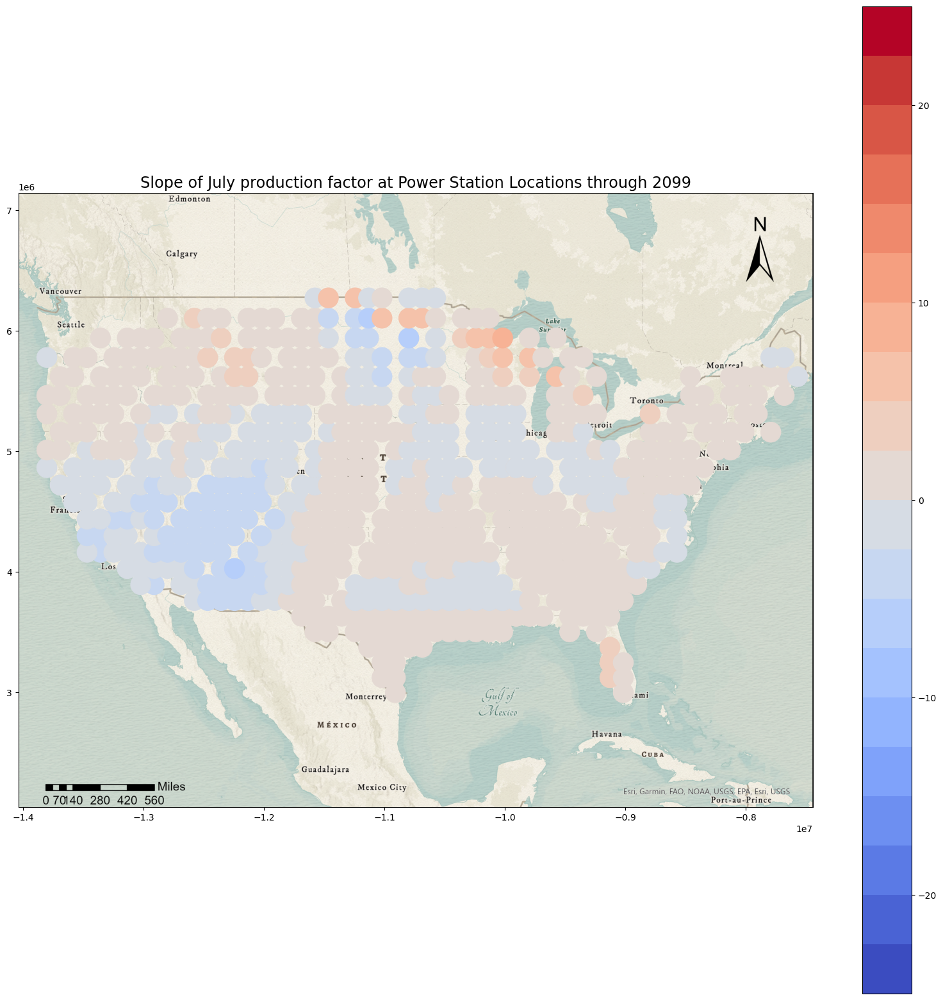

In [847]:
# Plotting temperature across all locations
from rasterio import plot as rasterplot
import matplotlib as mpl

N = 20

cmap = plt.get_cmap(colormap, N)

fig, ax = plt.subplots(figsize = (20,20))

rasterplot.show(basemap, ax = ax, cmap = 'gray', extent = extent)

sites.plot(ax = ax, column = 'slope 7', cmap = cmap, legend = True, markersize = 500, marker = 'o', vmin = miniv, vmax = maxiv)

plt.title('Slope of July production factor at Power Station Locations through 2099', fontsize = 'xx-large')

plt.savefig(base_path / 'slope_July.pdf')
plt.savefig(base_path / '7.png')

plt.show()



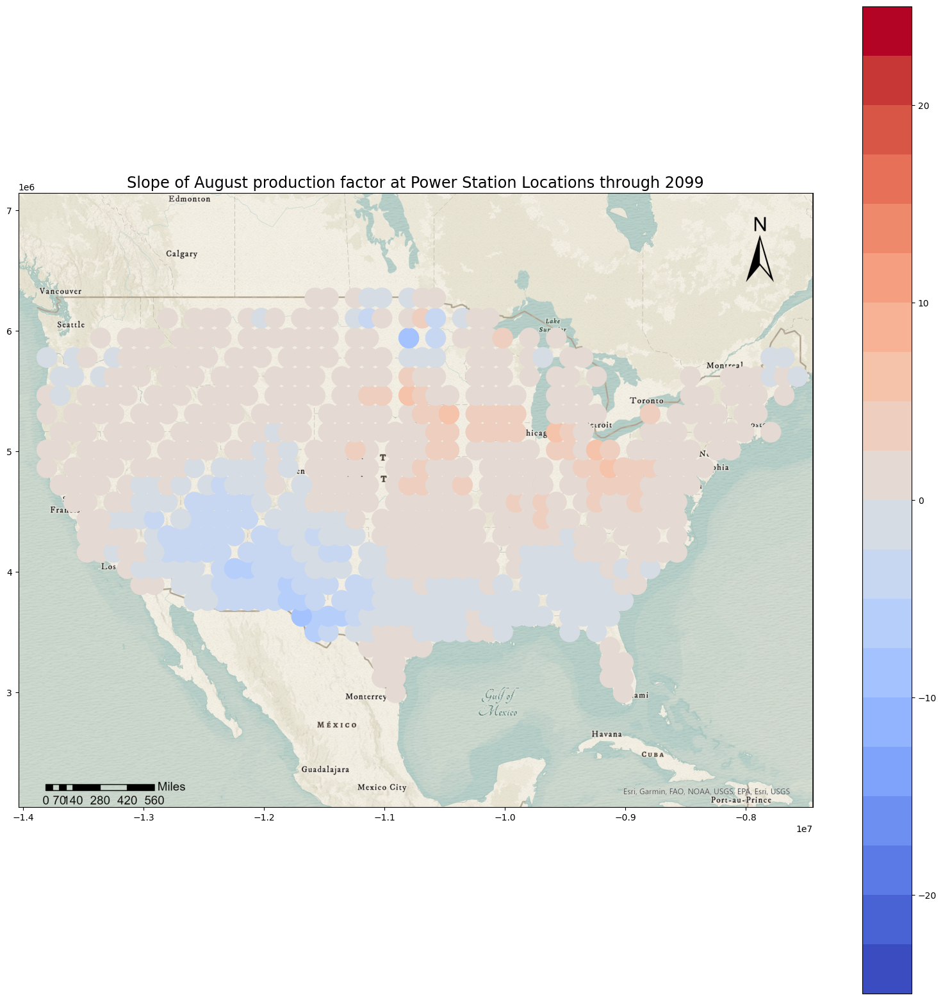

In [848]:
# Plotting temperature across all locations
from rasterio import plot as rasterplot
import matplotlib as mpl

N = 20

cmap = plt.get_cmap(colormap, N)

fig, ax = plt.subplots(figsize = (20,20))

rasterplot.show(basemap, ax = ax, cmap = 'gray', extent = extent)

sites.plot(ax = ax, column = 'slope 8', cmap = cmap, legend = True, markersize = 500, marker = 'o', vmin = miniv, vmax = maxiv)

plt.title('Slope of August production factor at Power Station Locations through 2099', fontsize = 'xx-large')

plt.savefig(base_path / 'slope_Aug.pdf')
plt.savefig(base_path / '8.png')

plt.show()



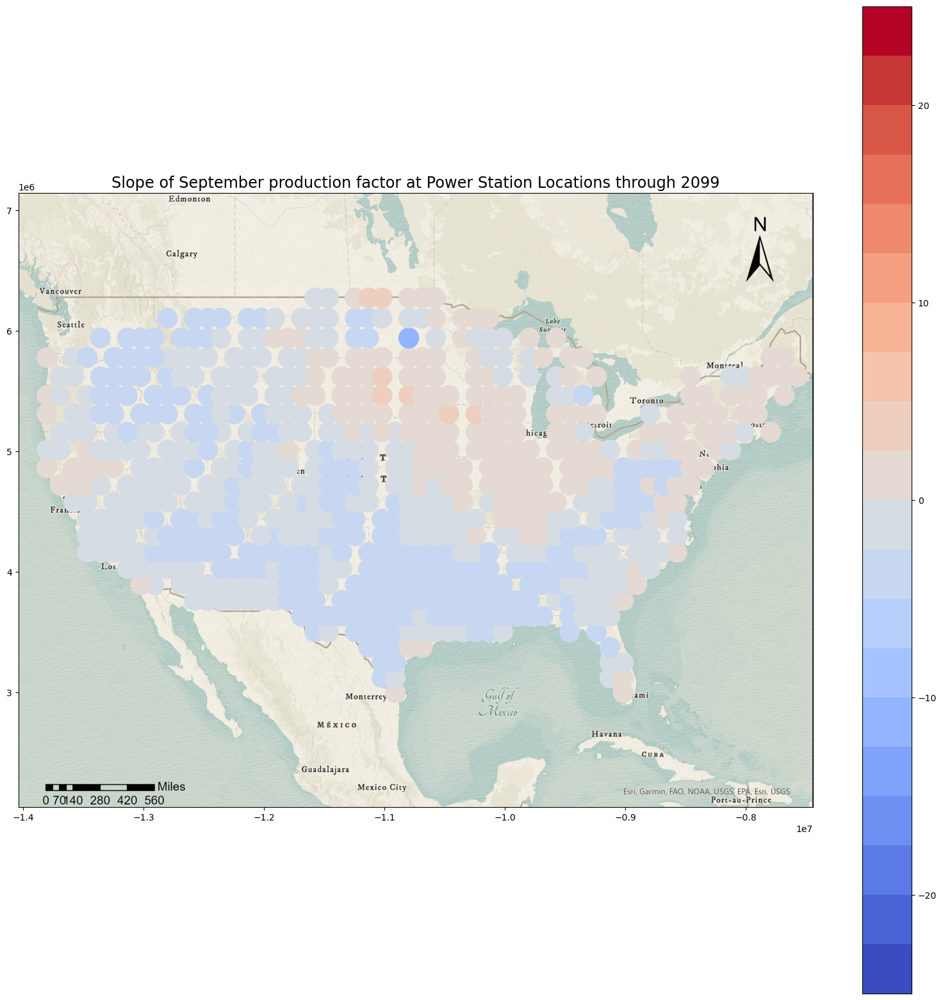

In [849]:
# Plotting temperature across all locations
from rasterio import plot as rasterplot
import matplotlib as mpl

N = 20

cmap = plt.get_cmap(colormap, N)

fig, ax = plt.subplots(figsize = (20,20))

rasterplot.show(basemap, ax = ax, cmap = 'gray', extent = extent)

sites.plot(ax = ax, column = 'slope 9', cmap = cmap, legend = True, markersize = 500, marker = 'o', vmin = miniv, vmax = maxiv)

plt.title('Slope of September production factor at Power Station Locations through 2099', fontsize = 'xx-large')

plt.savefig(base_path / 'slope_Sept.pdf')
plt.savefig(base_path / '9.png')

plt.show()



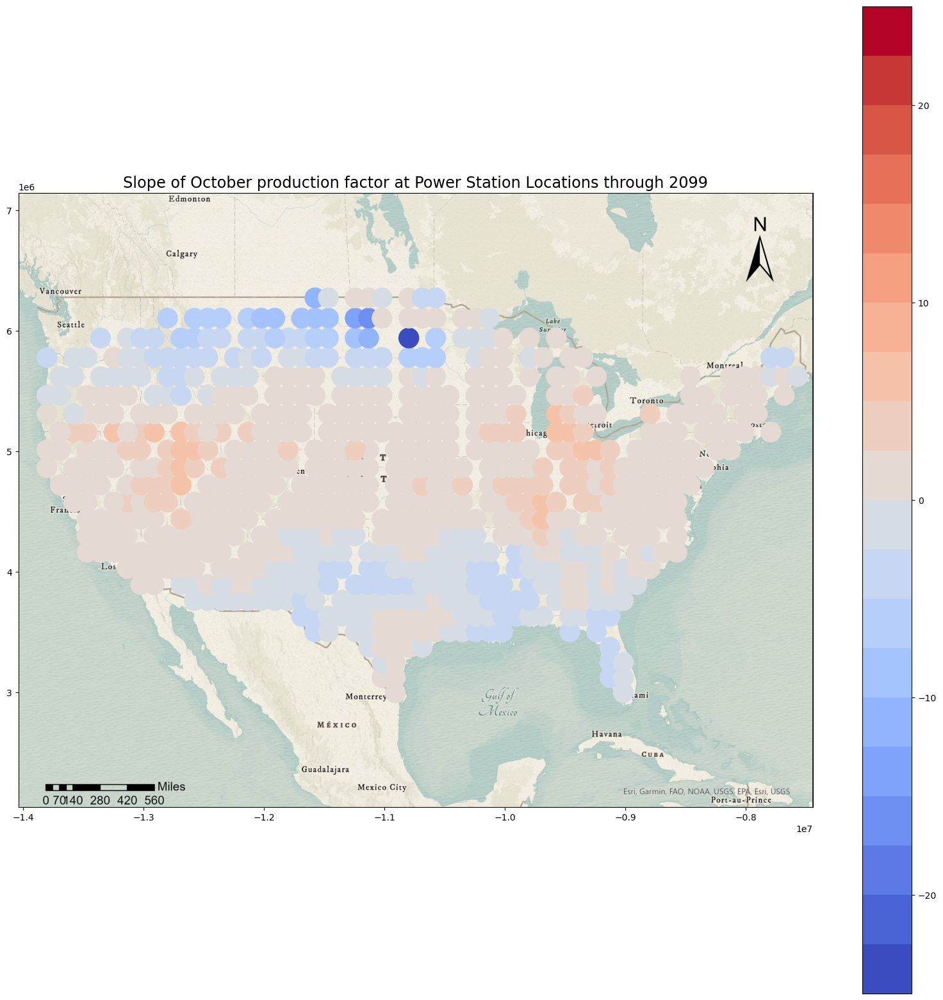

In [850]:
# Plotting temperature across all locations
from rasterio import plot as rasterplot
import matplotlib as mpl

N = 20

cmap = plt.get_cmap(colormap, N)

fig, ax = plt.subplots(figsize = (20,20))

rasterplot.show(basemap, ax = ax, cmap = 'gray', extent = extent)

sites.plot(ax = ax, column = 'slope 10', cmap = cmap, legend = True, markersize = 500, marker = 'o', vmin = miniv, vmax = maxiv)

plt.title('Slope of October production factor at Power Station Locations through 2099', fontsize = 'xx-large')

plt.savefig(base_path / 'slope_Oct.pdf')
plt.savefig(base_path / '10.png')

plt.show()



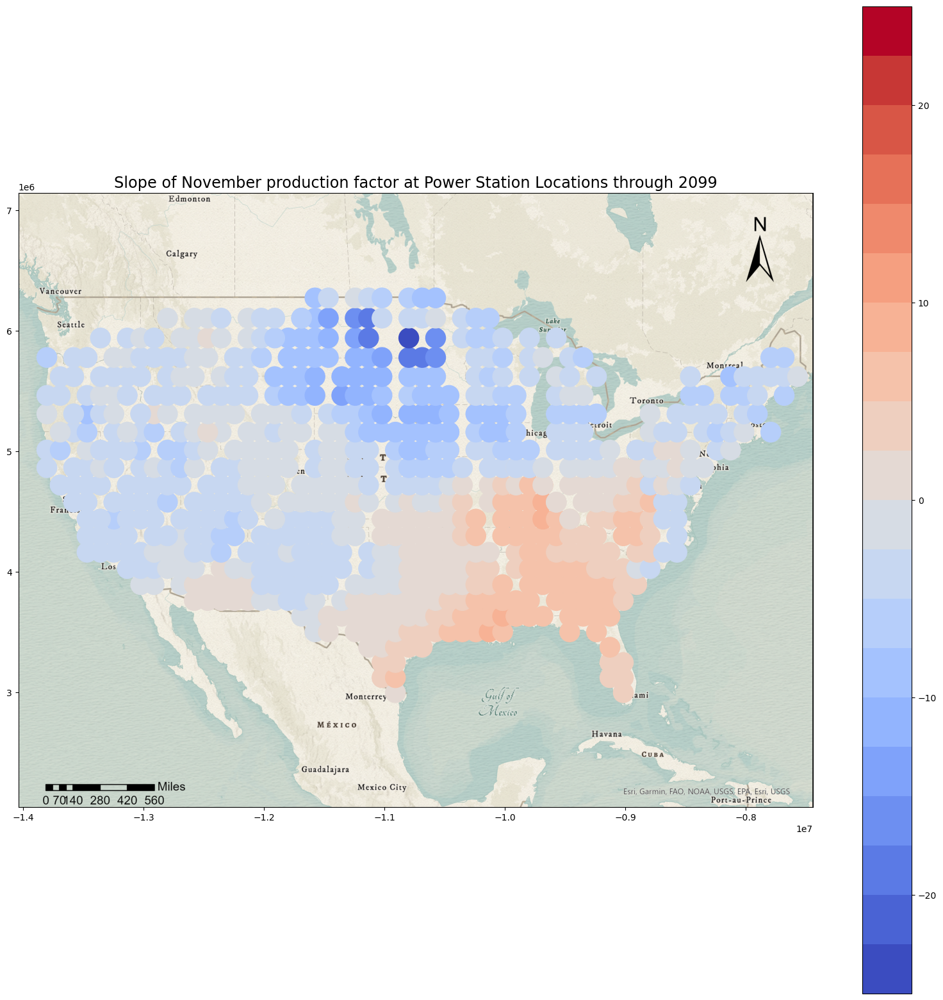

In [851]:
# Plotting temperature across all locations
from rasterio import plot as rasterplot
import matplotlib as mpl

N = 20

cmap = plt.get_cmap(colormap, N)

fig, ax = plt.subplots(figsize = (20,20))

rasterplot.show(basemap, ax = ax, cmap = 'gray', extent = extent)

sites.plot(ax = ax, column = 'slope 11', cmap = cmap, legend = True, markersize = 500, marker = 'o', vmin = miniv, vmax = maxiv)

plt.title('Slope of November production factor at Power Station Locations through 2099', fontsize = 'xx-large')

plt.savefig(base_path / 'slope_Nov.pdf')
plt.savefig(base_path / '11.png')

plt.show()



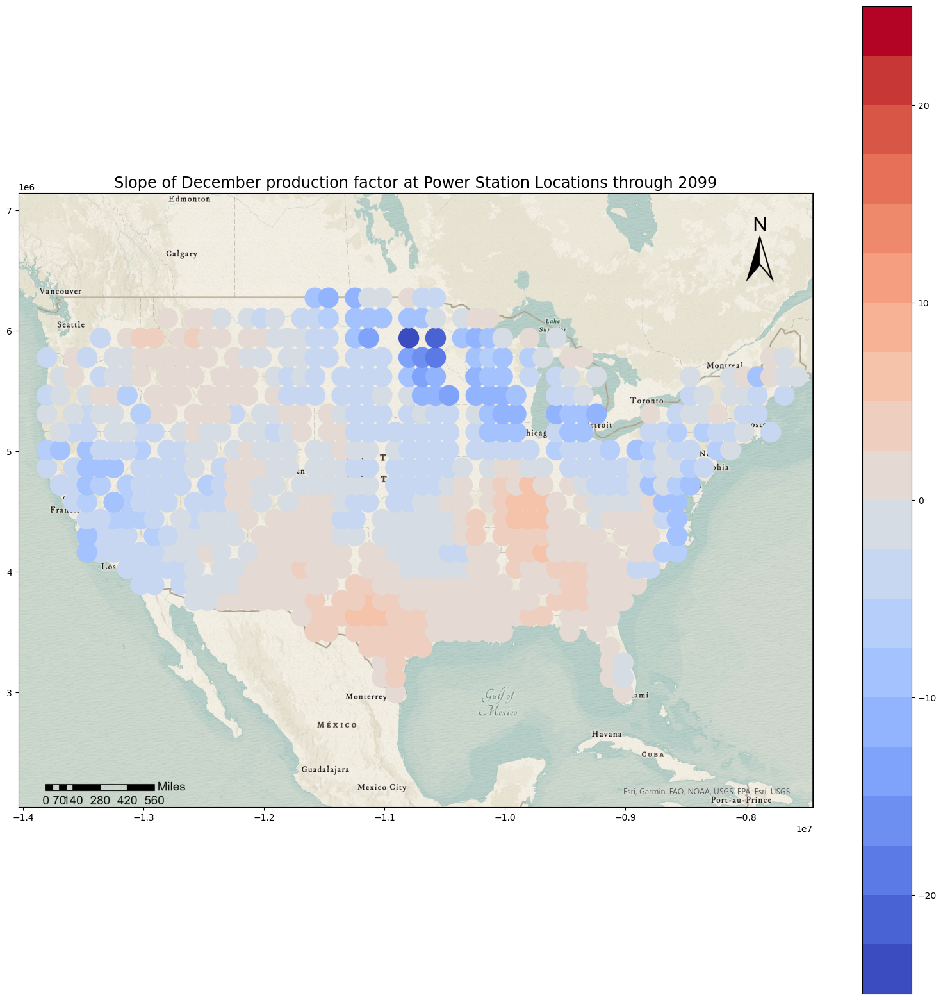

In [852]:
# Plotting temperature across all locations
from rasterio import plot as rasterplot
import matplotlib as mpl

N = 20

cmap = plt.get_cmap(colormap, N)

fig, ax = plt.subplots(figsize = (20,20))

rasterplot.show(basemap, ax = ax, cmap = 'gray', extent = extent)

sites.plot(ax = ax, column = 'slope 12', cmap = cmap, legend = True, markersize = 500, marker = 'o', vmin = miniv, vmax = maxiv)

plt.title('Slope of December production factor at Power Station Locations through 2099', fontsize = 'xx-large')

plt.savefig(base_path / 'slope_Dec.pdf')
plt.savefig(base_path / '12.png')

plt.show()

